#**Importing the Required Libraries**

In [55]:
import os


In [56]:
import glob

In [57]:
from IPython.display import Image, display

In [58]:
from IPython import display

In [59]:
display.clear_output()

# **In the First Step, We need to check whether we have access to the GPU or not**

In [60]:
!nvidia-smi

Mon Dec  9 09:12:20 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8               9W /  70W |      3MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [61]:
HOME = os.getcwd()

In [62]:
print(HOME)

/content


#**Installing Ultralytics using Pip Install**

In [63]:
!pip install ultralytics

##Checking whether YOLOv8 is Installed and its working Fine

In [64]:
import ultralytics

In [65]:
ultralytics.checks()

Ultralytics 8.3.48 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.7/112.6 GB disk)


#**Importing the American Sign Language Alphabets Dataset from Roboflow**

In [66]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="NvtepvuP2r2Hu4ceJjJV")
project = rf.workspace("david-lee-d0rhs").project("american-sign-language-letters")
version = project.version(1)
dataset = version.download("yolov5")

loading Roboflow workspace...
loading Roboflow project...


#**Train the YOLOv8 Model on the Custom Dataset**

In [67]:
%cd {HOME}

/content


In [68]:
%cd {dataset.location}

/content/American-Sign-Language-Letters-1


In [74]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8l.pt data={dataset.location}/data.yaml epochs=50 imgsz=800

/content
Ultralytics 8.3.48 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8l.pt, data=/content/American-Sign-Language-Letters-1/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=800, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labe

In [75]:
!ls {HOME}/runs/detect/train8/

args.yaml					    R_curve.png		 val_batch0_labels.jpg
confusion_matrix_normalized.png			    results.csv		 val_batch0_pred.jpg
confusion_matrix.png				    results.png		 val_batch1_labels.jpg
events.out.tfevents.1733735784.c36a069d0b86.5475.0  train_batch0.jpg	 val_batch1_pred.jpg
F1_curve.png					    train_batch1.jpg	 val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch2.jpg	 val_batch2_pred.jpg
labels.jpg					    train_batch3800.jpg  weights
P_curve.png					    train_batch3801.jpg
PR_curve.png					    train_batch3802.jpg


#**Displaying the Confusion Matrix**

/content


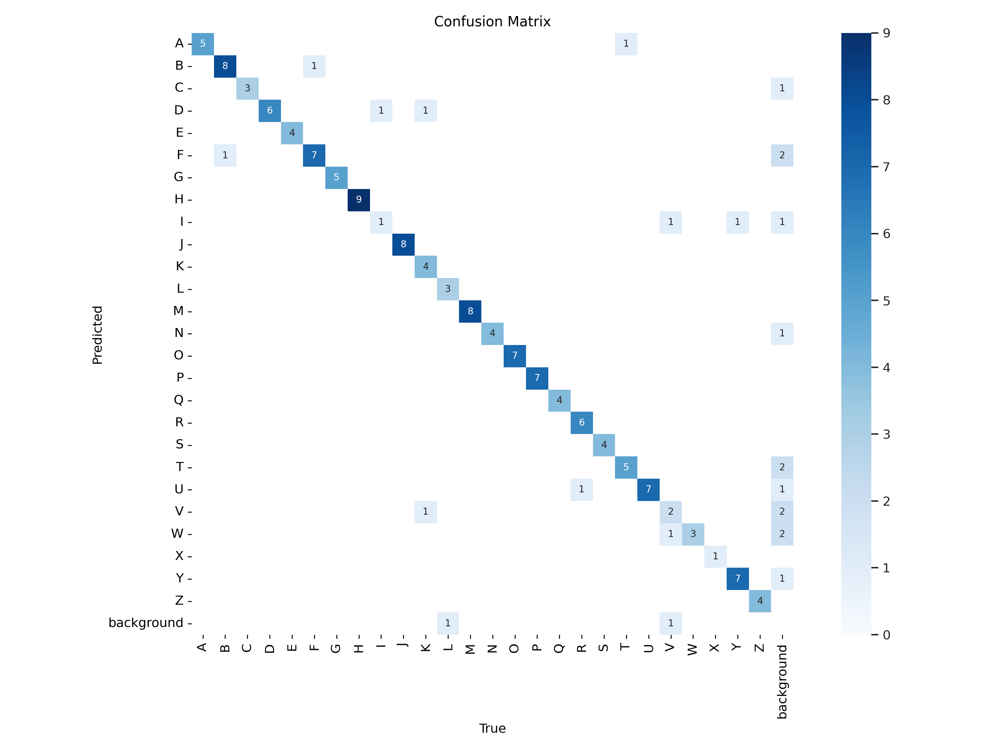

In [76]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train8/confusion_matrix.png', width=900)

#**Training and Validation Loss**

/content


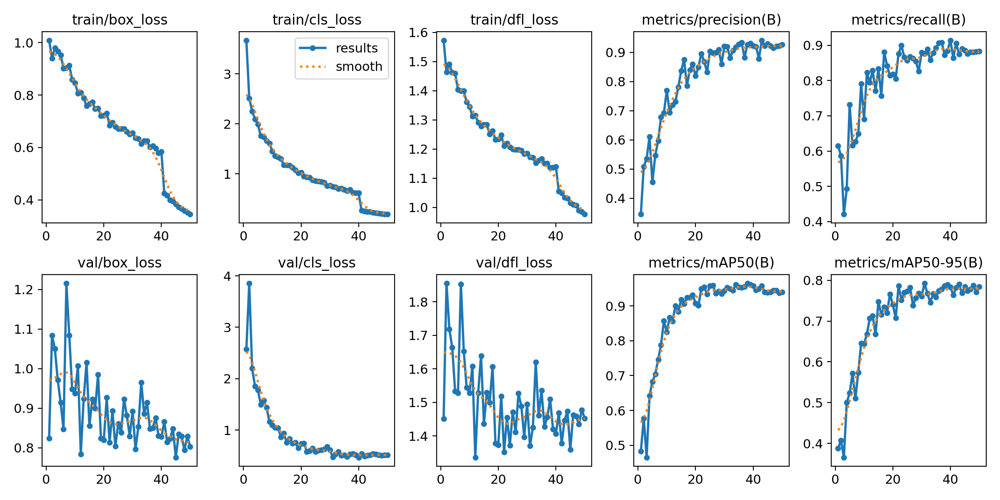

In [79]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train8/results.png', width=600)

/content


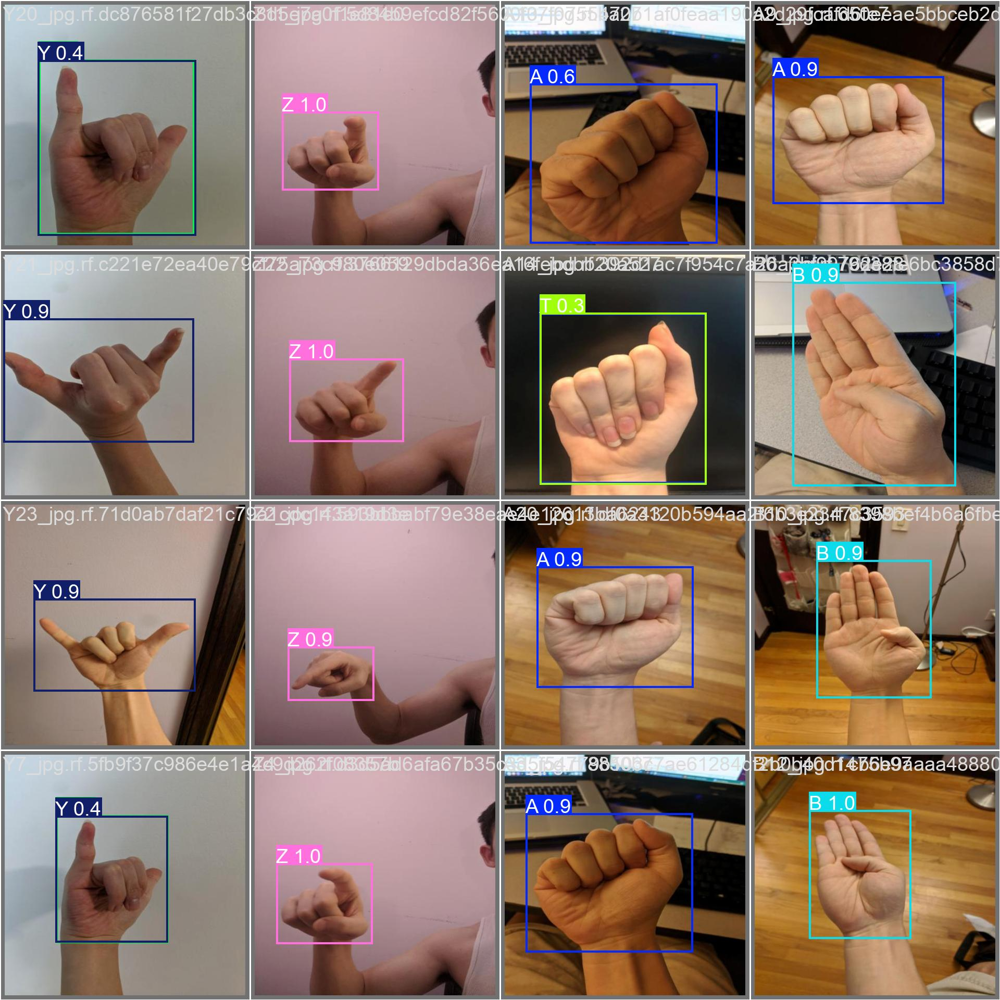

In [80]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train8/val_batch0_pred.jpg', width=600)

#**Validate Custom Model**

In [82]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train8/weights/best.pt data={dataset.location}/data.yaml

/content
Ultralytics 8.3.48 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43,626,654 parameters, 0 gradients, 164.9 GFLOPs
val: Scanning /content/American-Sign-Language-Letters-1/valid/labels.cache... 144 images, 0 backgrounds, 0 corrupt: 100% 144/144 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 9/9 [00:08<00:00,  1.00it/s]
                   all        144        144       0.92      0.876      0.953      0.793
                     A          5          5      0.758       0.63      0.928      0.785
                     B          9          9      0.987      0.889      0.975      0.857
                     C          3          3      0.936          1      0.995      0.863
                     D          6          6      0.838      0.866      0.972      0.819
                     E          4          4      0.962          1      0.995      0.872
                     

#**Inference with Custom Model**

In [85]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train8/weights/best.pt conf=0.25 source={dataset.location}/test/images

/content
Ultralytics 8.3.48 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43,626,654 parameters, 0 gradients, 164.9 GFLOPs

image 1/72 /content/American-Sign-Language-Letters-1/test/images/A22_jpg.rf.f02ad8558ce1c88213b4f83c0bc66bc8.jpg: 800x800 1 A, 101.9ms
image 2/72 /content/American-Sign-Language-Letters-1/test/images/B14_jpg.rf.ed5ba6d44f55ab03e62d2baeac4aa1aa.jpg: 800x800 1 B, 59.9ms
image 3/72 /content/American-Sign-Language-Letters-1/test/images/B15_jpg.rf.0f0628552139144fc67c453e1f1b7b15.jpg: 800x800 1 B, 59.8ms
image 4/72 /content/American-Sign-Language-Letters-1/test/images/B19_jpg.rf.69527cc1f34d694cc04e55db80ed9b1a.jpg: 800x800 1 B, 59.8ms
image 5/72 /content/American-Sign-Language-Letters-1/test/images/C17_jpg.rf.ceb81f8ae3c3673bd060ebe71848eca8.jpg: 800x800 1 C, 55.9ms
image 6/72 /content/American-Sign-Language-Letters-1/test/images/C19_jpg.rf.577ce02a223c65e89dc4a4eacd130040.jpg: 800x800 1 C, 56.5ms
image 7/72 /content

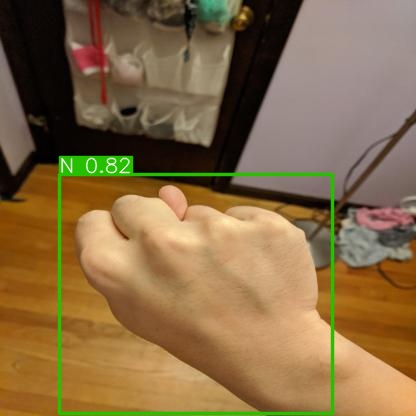

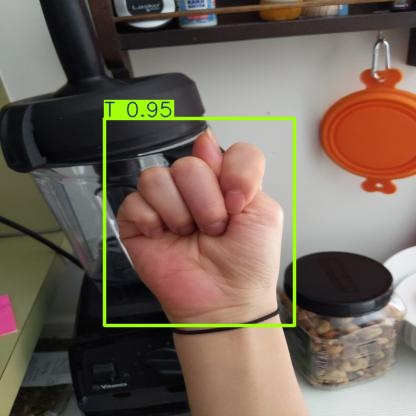

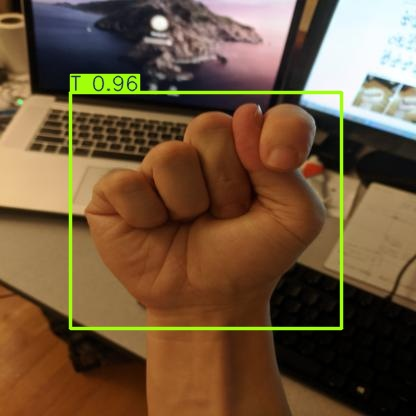

In [87]:
from IPython.display import Image, display # Import Image from IPython.display

for image_path in glob.glob(f'{HOME}/runs/detect/predict/*.jpg')[:3]:
      display(Image(filename=image_path, width=600))
      print("\n")

#**Testing on a Demo Video**

In [96]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train8/weights/best.pt conf=0.25 source='/content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4'

/content
Ultralytics 8.3.48 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 43,626,654 parameters, 0 gradients, 164.9 GFLOPs

video 1/1 (frame 1/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 63.9ms
video 1/1 (frame 2/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 55.3ms
video 1/1 (frame 3/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 1 U, 55.4ms
video 1/1 (frame 4/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 1 U, 42.2ms
video 1/1 (frame 5/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 1 U, 42.2ms
video 1/1 (frame 6/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 1 U, 41.2ms
video 1/1 (frame 7/897) /content/drive/MyDrive/Colab Notebooks/video_20241209_184223.mp4: 800x480 1 B, 1 U, 40.9ms
video 1/1 (frame 8/897) /cont

#**Display the Demo Video**

In [92]:
#!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [97]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/detect/predict3/video_20241209_184223.avi'

# Compressed video path
compressed_path = "/content/result_compressed2.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)